# 2. Image Enhancement

## Table of Contents
1. [Libraries](#libraries)
2. [Histogram Equalization](#hist)
3. [Denoising with Filters](#denoising)
4. [Challenge](#challenge)

## Importing Libraries <a class="anchor" id="libraries" ></a>

In [ ]:
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
from skimage import exposure
import skimage
from scipy.ndimage.filters import gaussian_filter as gauss
from scipy.ndimage.filters import median_filter as med
import cv2

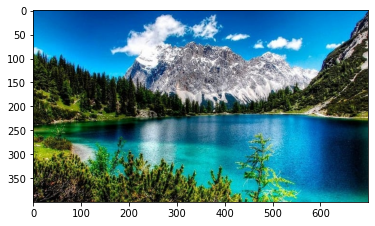

In [ ]:
original_image = Image.open('data/image.jpg')
plt.imshow(original_image)
type(original_image)

# Save the image
np.save('data/img.npy', original_image)

#Load the image
original_image = np.load('data/img.npy')

## Histogram Equalization<a class="anchor" id="hist" ></a>

Let's look at the distribution of pixel values in the image. 

Ideally, the image should have relatively even distribution of values, indicating good contrast and making it easier to extract analytical information.

An easy way to check this is to plot a histogram.

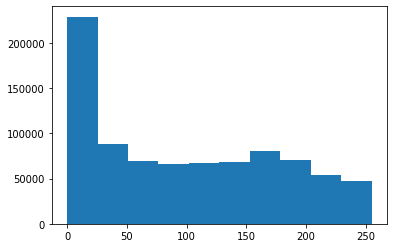

In [ ]:
# Plot a histogram - we need to use ravel to "flatten" the 3 dimensions
plt.hist(original_image.ravel())
plt.show()

Another useful way to visualize the statistics of an image is as a cumulative distribution function (CDF) plot. Which shows the cumulative pixel intensity frequencies from 0 to 255.

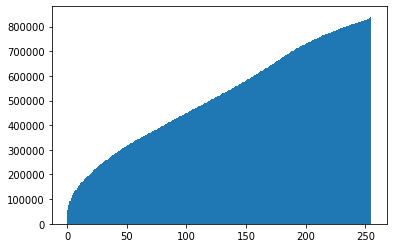

In [ ]:
plt.hist(original_image.ravel(), bins=255, cumulative=True)
plt.show()

The histogram and CDF for our image show pretty uneven distribution - there's a lot of contrast in the image. Ideally we should equalize the values in the images we want to analyse to try to make our images more consistent in terms of the shapes they contain irrespective of light levels.

Histogram equalization is often used to improve the statistics of images. In simple terms, the histogram equalization algorithm attempts to adjust the pixel values in the image to create a more uniform distribution. The code in the cell below uses the  **exposure.equalize_hist** method from the **skimage** package to equalize the image.  

c:\ProgramData\Anaconda3\envs\PhD\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


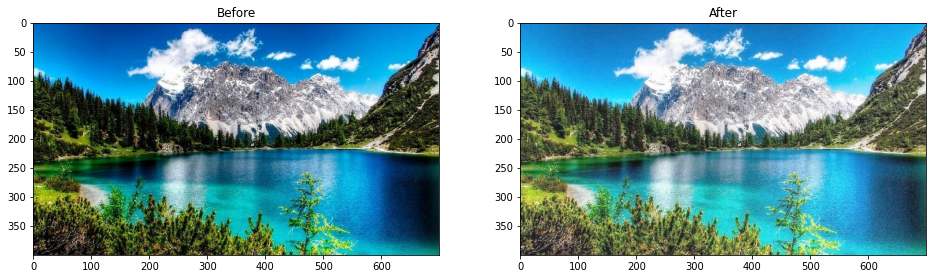

In [ ]:
original_image_eq = exposure.equalize_hist(original_image)

fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.imshow(original_image)
a.set_title('Before')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.imshow(original_image_eq)
a.set_title('After')

plt.show()

As with most image operations, there's more than one way to do this. For example, you could also use the **PIL.ImgOps.equalize** method:

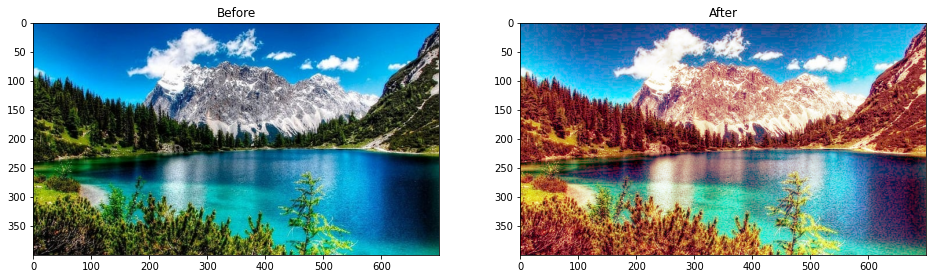

In [ ]:

# Equalize the image - but we need to convert the numpy array back to the PIL image format
image_PIL_eq = ImageOps.equalize(Image.fromarray(original_image))

# Display using matplotlib

# Create a figure
fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.imshow(original_image)
a.set_title('Before')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.imshow(image_PIL_eq)
a.set_title('After')

plt.show()

Now let's see what that's done to the histogram and CDF plots:

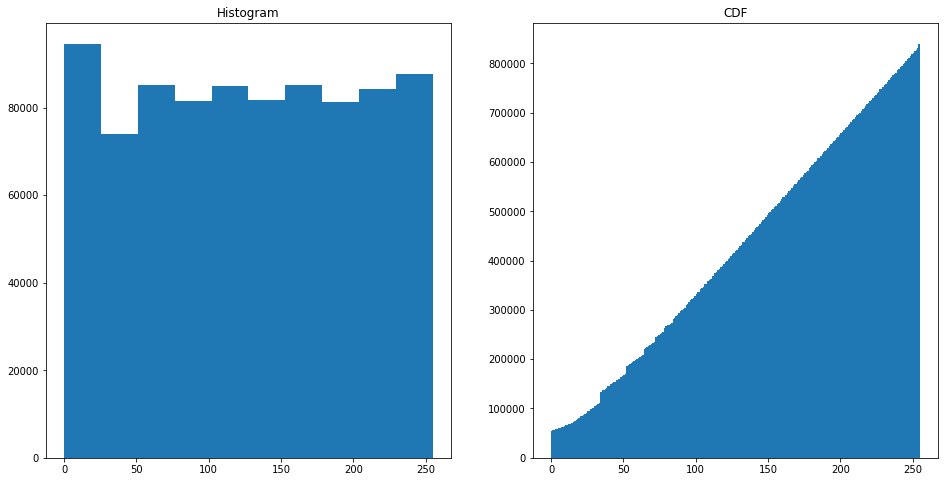

In [ ]:
# Display histograms
img_eq = np.array(image_PIL_eq)

# Create a figure
fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.hist(img_eq.ravel())
a.set_title('Histogram')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.hist(img_eq.ravel(), bins=255, cumulative=True)
a.set_title('CDF')

plt.show()

The pixel intensities are more evenly distributed in the equalized image. In particular, the cumulative density shows a straight diagonal cumulation; which is a good sign that the pixel intensity values have been equalized.

## Denoising with Filters <a class="anchor" id="denoising" ></a>

Often images need to be cleaned up to remove "salt and pepper" noise.

### Add Some Random Noise
Let's add some random noise to our image - such as you might see in a photograph taken in low light or at a low resolution.

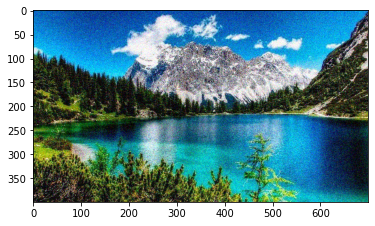

In [ ]:
img_n = skimage.util.random_noise(original_image)
plt.imshow(img_n)

### Using a Gaussian Filter
A Gaussian filter applies a weighted average (mean) value for pixels based on the pixels that surround them.

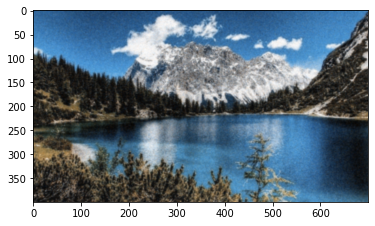

In [ ]:
img3_gauss = gauss(img_n, sigma=1)   
plt.imshow(img3_gauss)

### Using a Median Filter
The Gaussian filter results in a blurred image, which may actually be better for feature extraction as it makes it easier to find contrasting areas. If it's too blurred, we could try a median filter, which as the name suggests applies the median value to pixels based on the pixels around them.

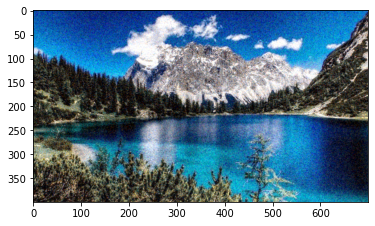

In [ ]:
img_med = med(img_n, size=2)
plt.imshow(img_med)

## Challenge <a class="anchor" id="challenge" ></a>

Now, try solving this challenge, you must equalize different windows of the same image in a splitted way.

In [ ]:
from image_slicer import slice

n = 4
slice('data/image.jpg', n)

(<Tile #1 - image_01_01.png>,
 <Tile #2 - image_01_02.png>,
 <Tile #3 - image_02_01.png>,
 <Tile #4 - image_02_02.png>)

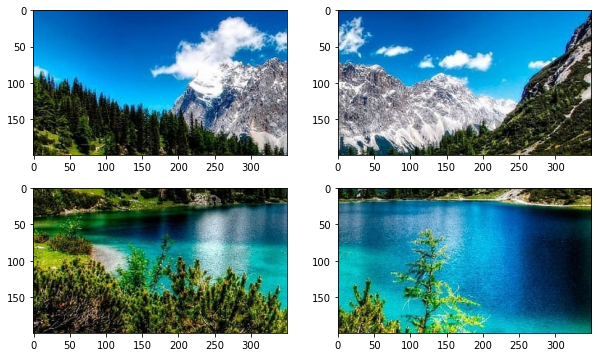

In [ ]:
fig = plt.figure(figsize=(10, 6))

plt.subplot(2,2,1)
img = Image.open(f'data/image_01_01.png')
plt.imshow(img)

plt.subplot(2,2,2)
img = Image.open(f'data/image_01_02.png')
plt.imshow(img)

plt.subplot(2,2,3)
img = Image.open(f'data/image_02_01.png')
plt.imshow(img)

plt.subplot(2,2,4)
img = Image.open(f'data/image_02_02.png')
plt.imshow(img)

plt.show()

# Algoritmos de mejoramiento de imágenes basado por pixeles

# Ejercicios 

Equipo 17: 

* José Miguel Guerrero Arias

* Josías Ruiz Peña

* Jesús Ángel Salazar Marcatoma

* Jorge Luis Tapia Peñaloza

* Juan Carlos Torres Luna



1. Investiga e implementa el método tile-based histogram equalization. En estos métodos, la imagen se particiona en diferentes ventanas (i.e. mosaicos) y los histogramas se calculan de forma independiente, aplicando la corrección sobre cada ventana. Existe un compromiso entre el tamaño de la ventana y la complejidad computacional, por lo cual es más complejo que el método simple. Implementa esta versión y realiza algunas pruebas variando el tamaño de la ventana. Otro inconveniente es que se puede observar posibles diferencias entre los el contraste de los bloques, ¿cómo podría mejorarse?



In [2]:
!pip install -q image_slicer

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 6.2 MB/s eta 0:00:00


In [56]:
from PIL import Image, ImageOps
from io import BytesIO
from image_slicer import slice, join
from image_slicer.main import Tile
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
import requests
plt.style.use('bmh')

In [4]:
def load_image_url(url):
  response = requests.get(url)
  img = Image.open(BytesIO(response.content))
  return img

In [149]:
path = "https://concepto.de/wp-content/uploads/2015/03/paisaje-e1549600034372.jpg"
img = load_image_url(path).resize((800,400))
img_array = np.array(img)
img_gray = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY)

In [48]:
img.save("image.png")

Tiles used to equalization:  50  0.4492




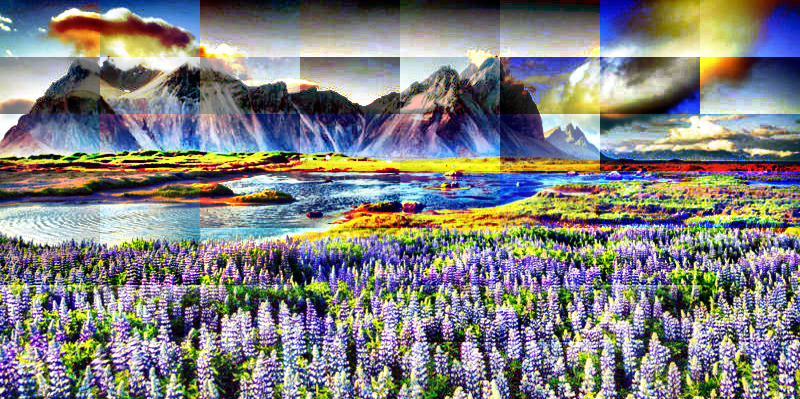

Tiles used to equalization:  60  0.1617




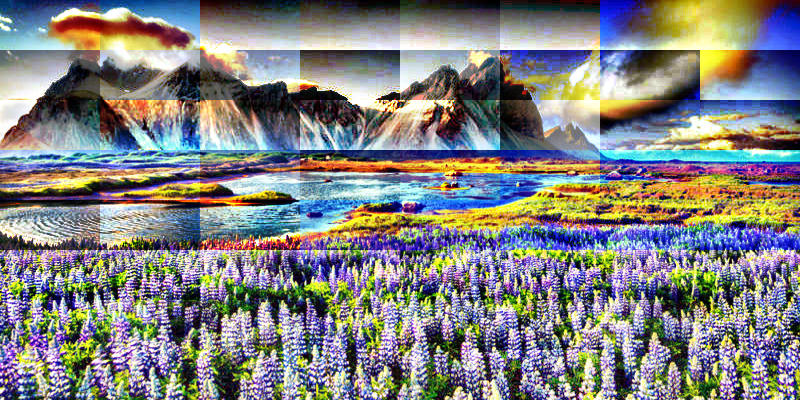

Tiles used to equalization:  70  0.1747




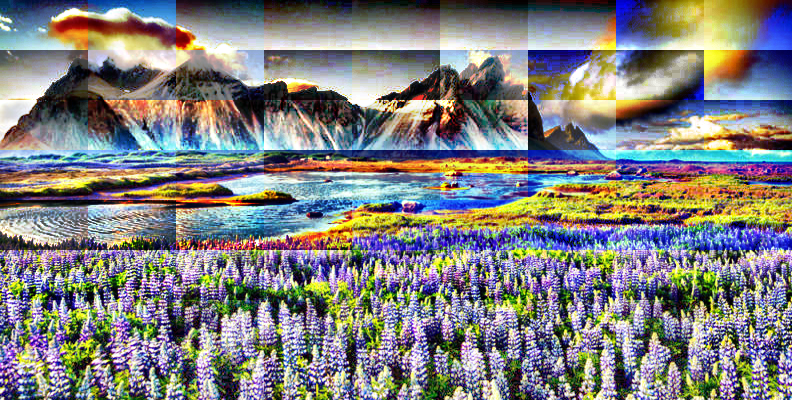

Tiles used to equalization:  80  0.1818




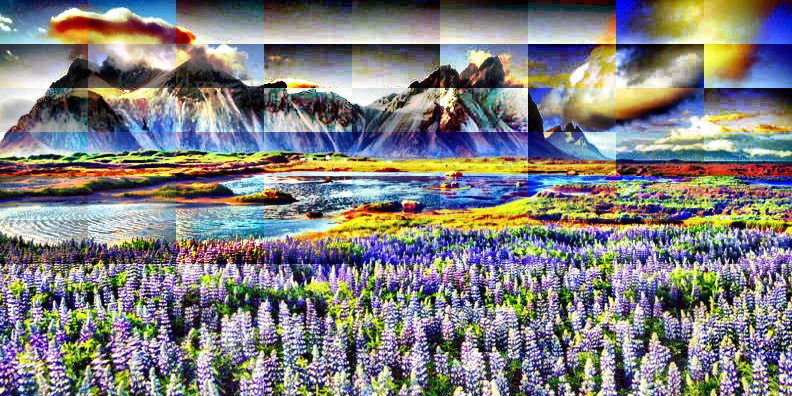

Tiles used to equalization:  90  0.2336




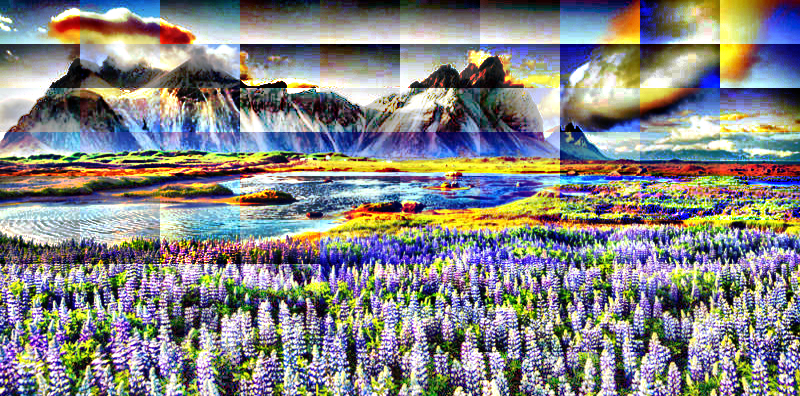

Tiles used to equalization:  100  0.1906




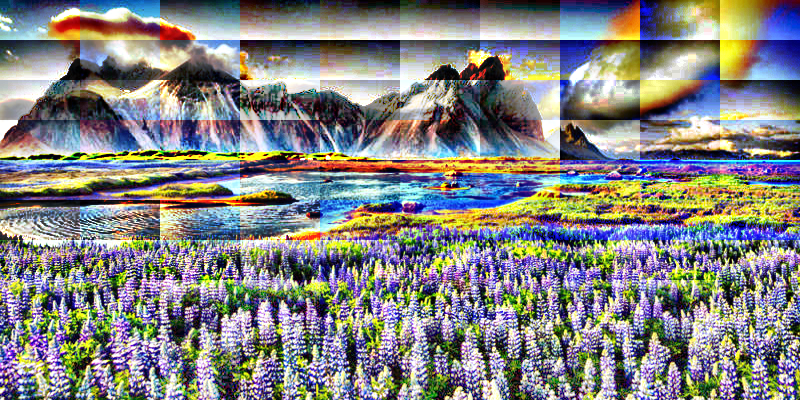

Tiles used to equalization:  110  0.2256




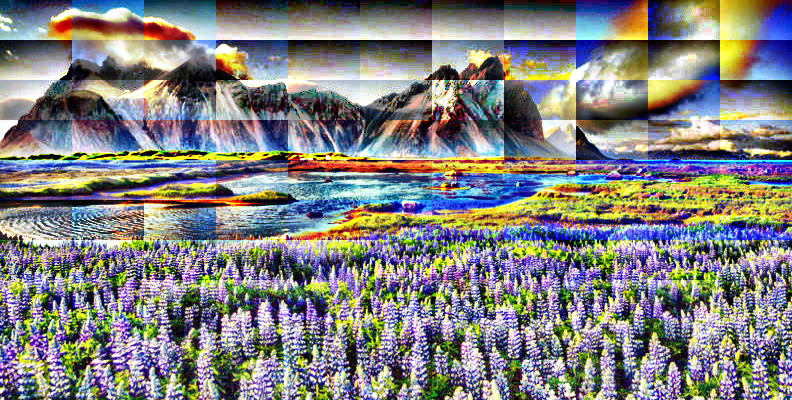

Tiles used to equalization:  120  0.2229




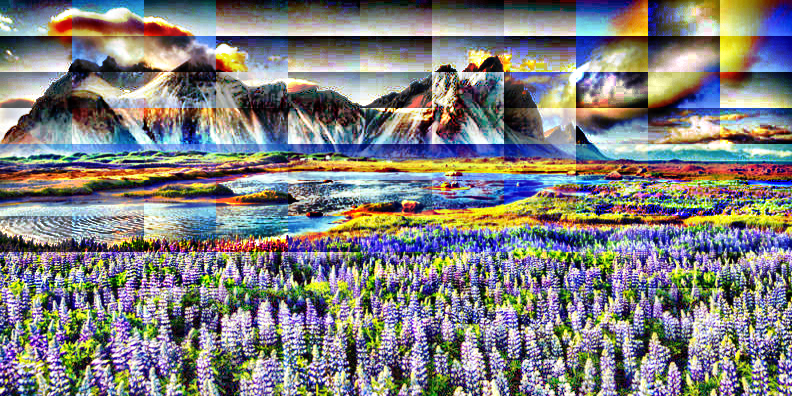

Tiles used to equalization:  130  0.2571




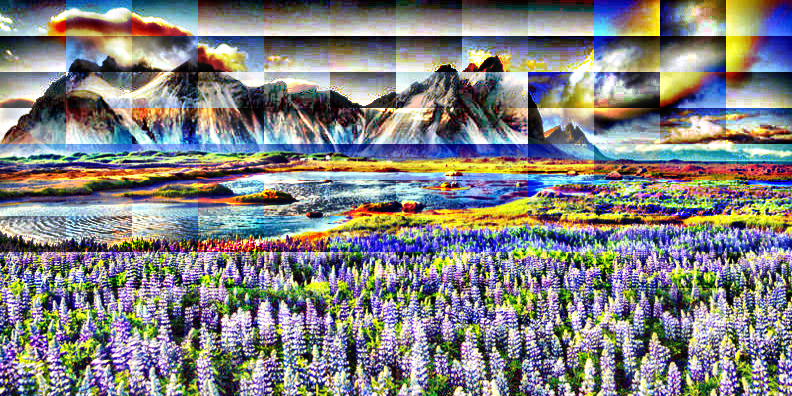

Tiles used to equalization:  140  0.2482




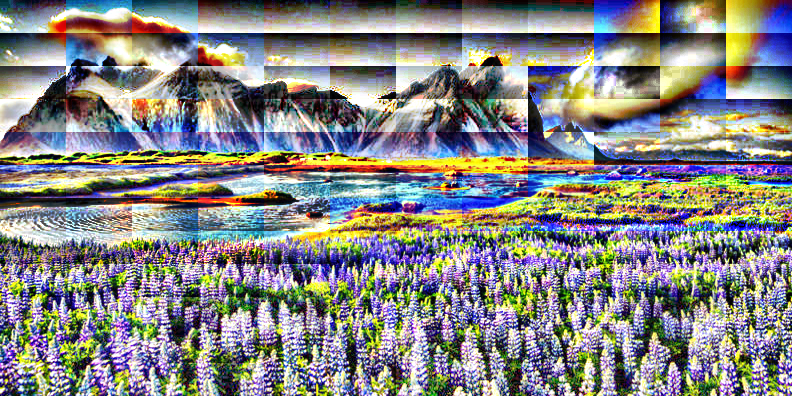

Tiles used to equalization:  150  0.2323




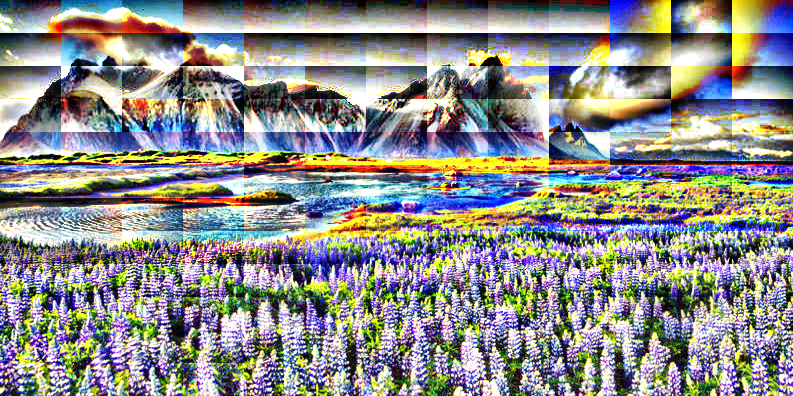

Tiles used to equalization:  160  0.2780




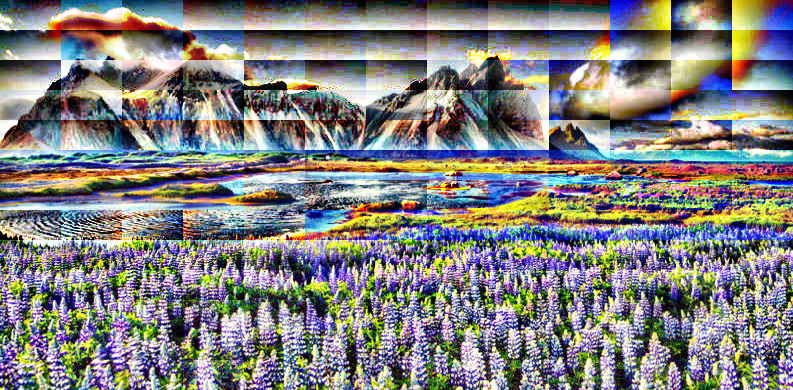

Tiles used to equalization:  170  0.2452




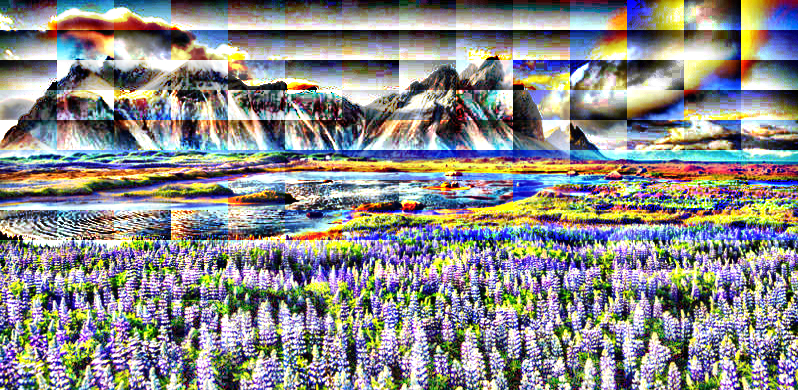

Tiles used to equalization:  180  0.2856




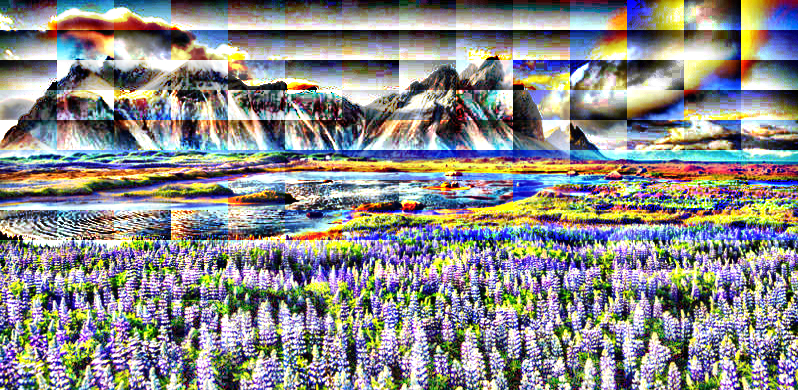

Tiles used to equalization:  190  0.2638




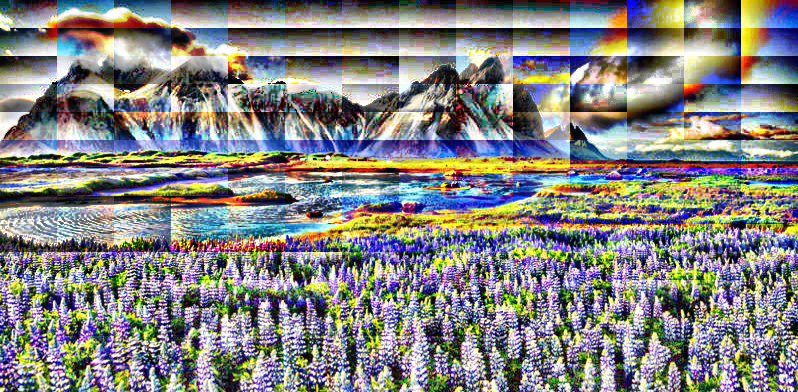

Tiles used to equalization:  200  0.3446




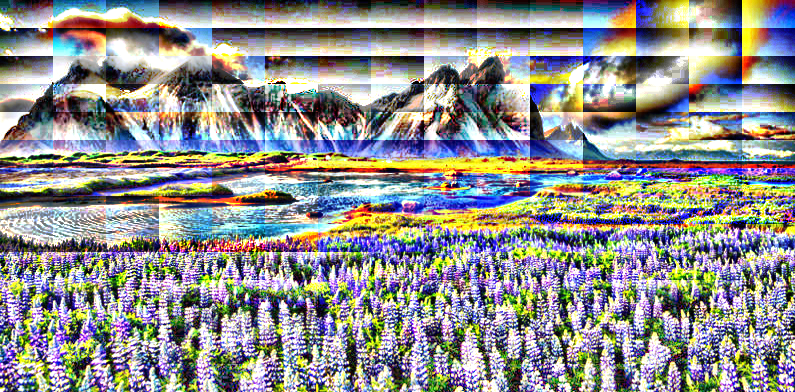

In [271]:
time_list = []
tiles_range = range(50,210,10)
for n in tiles_range:
  time_init = time.time()
  tiles = slice('image.png', n)
  for tile in tiles:
    tile.image = ImageOps.equalize(tile.image, )
  time_taken = time.time() - time_init
  print("Tiles used to equalization: ", n, f"{time_taken: .4f}" )
  print("\n")
  time_list.append(time_taken)
  display(join(tiles))

Text(0, 0.5, 'Time')

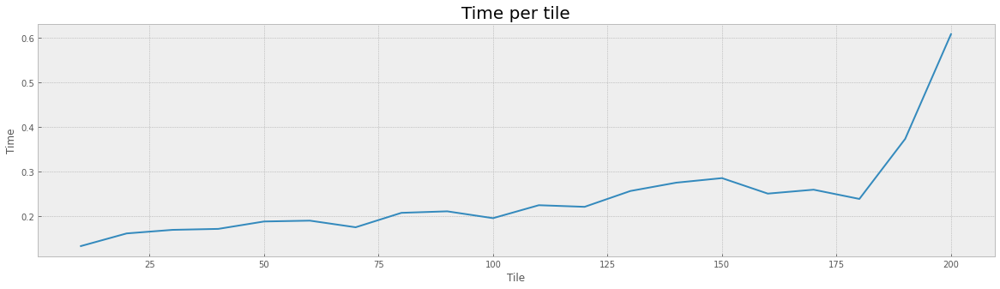

In [ ]:
plt.figure(figsize = (20,5))
plt.plot(tiles_range,time_list);
plt.title("Time per tile", fontdict={"size": 20})
plt.xlabel('Tile')
plt.ylabel('Time');

In [50]:
img_tile_equalized = join(tiles).convert('RGB')

In [55]:
type(tiles[0])

image_slicer.main.Tile

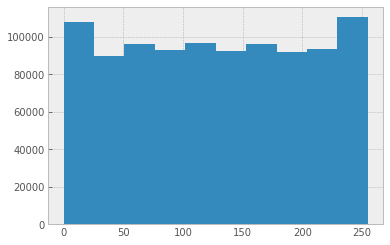

In [ ]:
plt.hist(np.array(img_tile_equalized).ravel());

2. Investiga e implementa un método sencillo del Sliding Window Adaptive Histogram Equalization (SWAHE) y compara algunas imágenes con diferentes tipos de imágenes.


In [231]:

def sliding_window(image, stepSize, windowSize):
	for y in range(0, image.shape[0], stepSize):
		for x in range(0, image.shape[1], stepSize):
			yield (x, y, image[y:y + windowSize[1], x:x + windowSize[0]])
def SWAHE(img_array,step_size = 1,window_size = (50,50)):  
  windows = sliding_window(img_array, step_size, window_size)
  img_empty = img_array.copy()
  for x,y,window in windows:  
    img_empty[y:y + window_size[1], x:x + window_size[0]] = np.array(ImageOps.equalize(Image.fromarray(window)))
  return img_empty

In [232]:
img_list = ["http://4.bp.blogspot.com/-R1OZRPI8sbI/TsQVgmYLPII/AAAAAAAAAcs/kGCZy9_PcIc/s1600/barbara.png",
"https://images.unsplash.com/photo-1590992133988-6ffb251c607e?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxzZWFyY2h8Mnx8Z3JheXNjYWxlfGVufDB8fDB8fA%3D%3D&w=1000&q=80",
 "https://media.geeksforgeeks.org/wp-content/uploads/gray.jpeg",
 "https://qph.cf2.quoracdn.net/main-qimg-28267274974ef4445d4e0464e2d382f1.webp"]

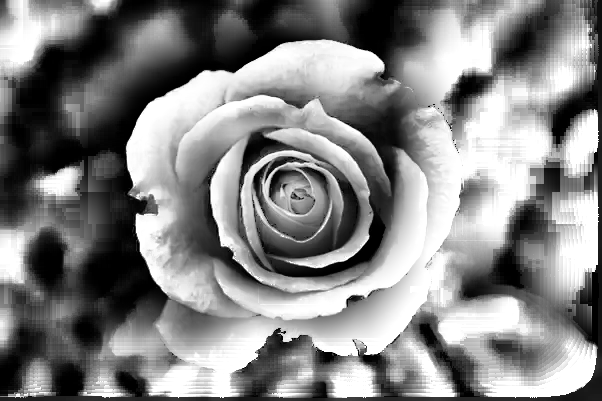

In [236]:
img_tile_equalized = SWAHE(img_array, step_size = 1, window_size = (64,64))
Image.fromarray(img_tile_equalized)

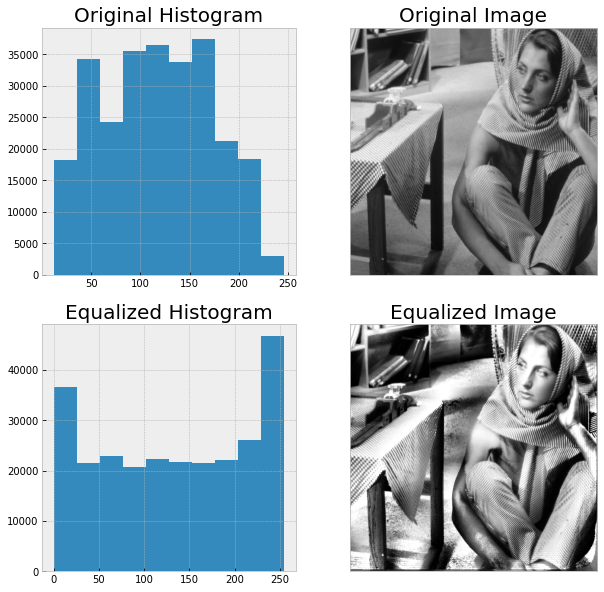

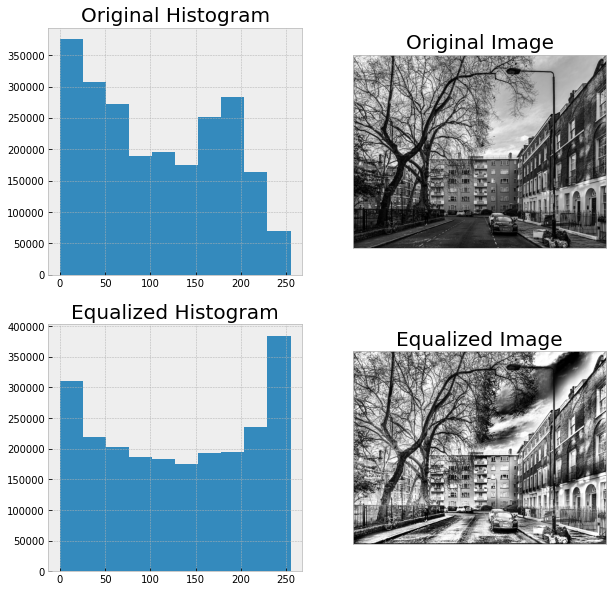

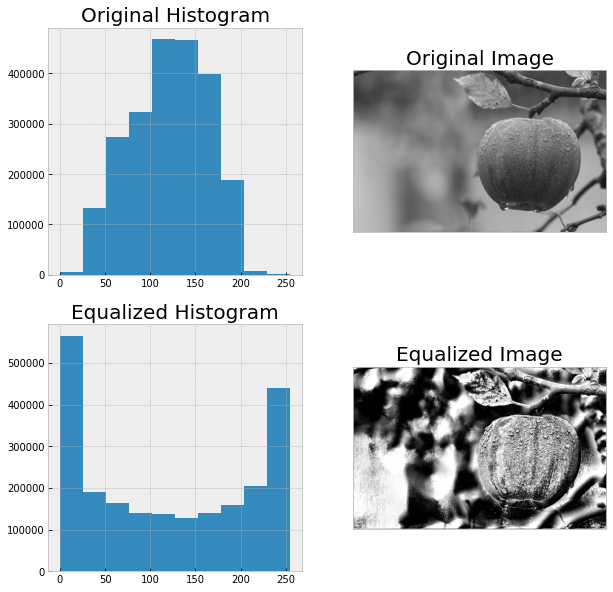

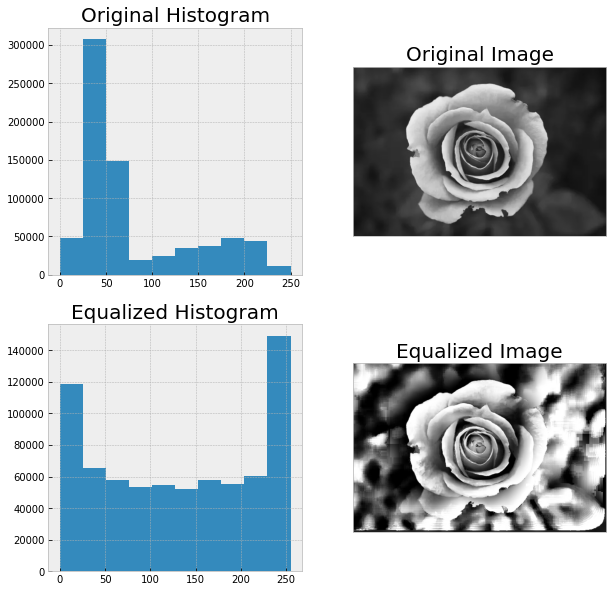

In [252]:
for path in img_list:
  img = load_image_url(path)
  img_array = np.array(img)
  img_tile_equalized = SWAHE(img_array, step_size = 1, window_size = (64,64))
  fig, axs = plt.subplots(2,2,figsize = (10,10))
  axs[0,0].hist(img_array.ravel())
  axs[0,1].imshow(img_array, cmap = "gray")
  axs[0,0].set_title("Original Histogram", fontdict = {'fontsize': 20})
  axs[0,1].set_title("Original Image", fontdict = {'fontsize': 20})
  axs[0,1].xaxis.set_visible(False)
  axs[0,1].yaxis.set_visible(False)
  axs[1,0].hist(img_tile_equalized.ravel())
  axs[1,1].imshow(img_tile_equalized, cmap = "gray")
  axs[1,0].set_title("Equalized Histogram", fontdict = {'fontsize': 20})
  axs[1,1].set_title("Equalized Image", fontdict = {'fontsize': 20})
  axs[1,1].xaxis.set_visible(False)
  axs[1,1].yaxis.set_visible(False)
  plt.show()


3. Investiga cómo funciona el algoritmo CLAHE (contrast limited adaptive histogram equalization) y realiza una implementación (puede ser usando la implementación de OpenCV). Prueba sobre diferentes tipos de imágenes y compara con el método de ecualización de histogramas básico. Provee una breve descripción del método a partir de una  investigación bibliográfica.


El AHE normal aumenta el contraste en regiones constantes de la imagen porque el histograma está muy concentrado en esas regiones. Como resultado, AHE puede provocar un aumento del ruido en condiciones casi estacionarias. El AHE con limitación de contraste (CLAHE) es una forma de ecualización de histograma adaptable en la que la mejora del contraste se limita a reducir el problema de la amplificación del ruido.

En CLAHE, la mejora del contraste alrededor de un valor de píxel determinado ya que es dada por la pendiente de la función de transformación. Es proporcional a la pendiente de la función de distribución de vecindad acumulada (CDF) y, por lo tanto, al valor del histograma para ese valor de píxel. CLAHE limita la ganancia recortando el histograma a un valor dado antes de calcular la CDF. Esto reduce la pendiente de la CDF y, por lo tanto, la función de transformación. El valor en el que se fija el histograma, denominado umbral de corte, depende de la normalización del histograma y, por lo tanto, del tamaño de la región vecina. Los valores típicos oscilan entre 3 y 4 para limitar la ganancia alcanzada.

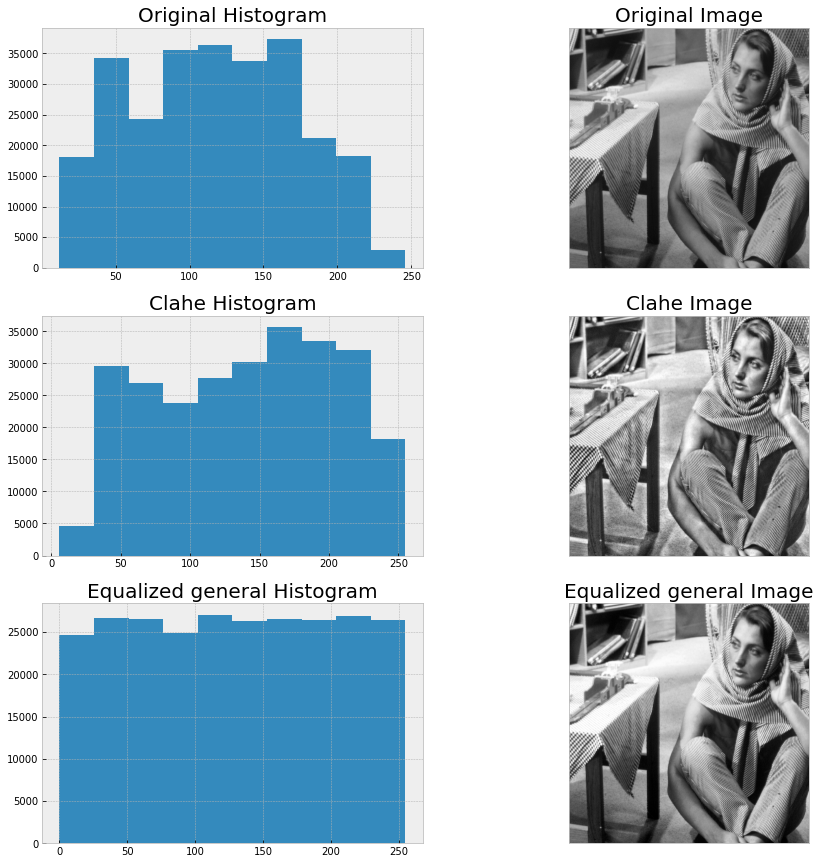

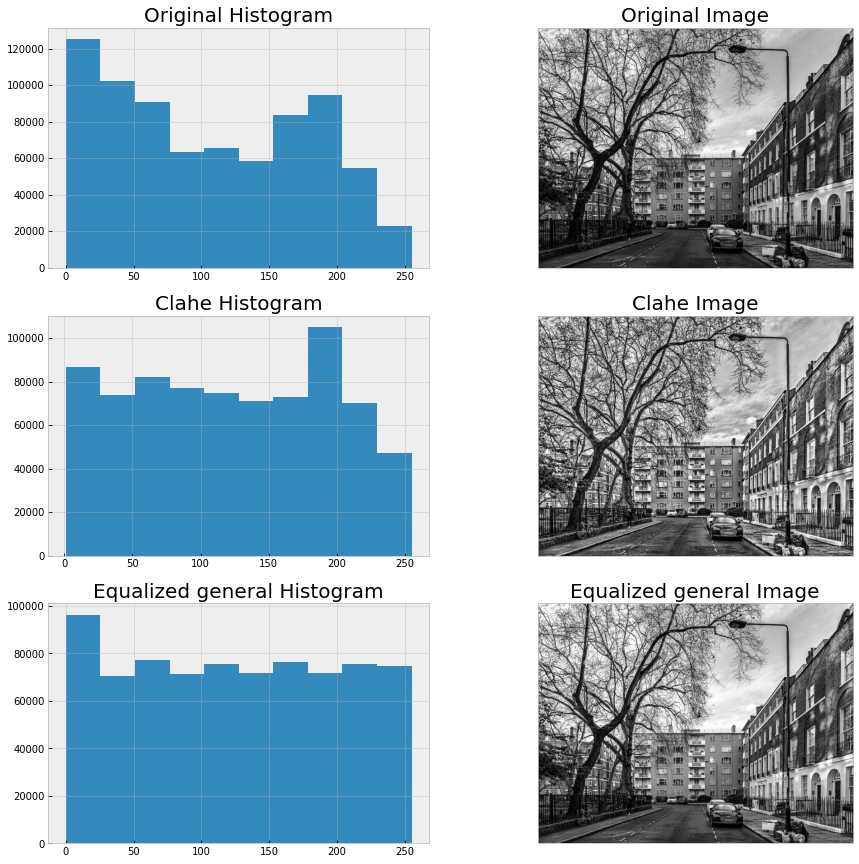

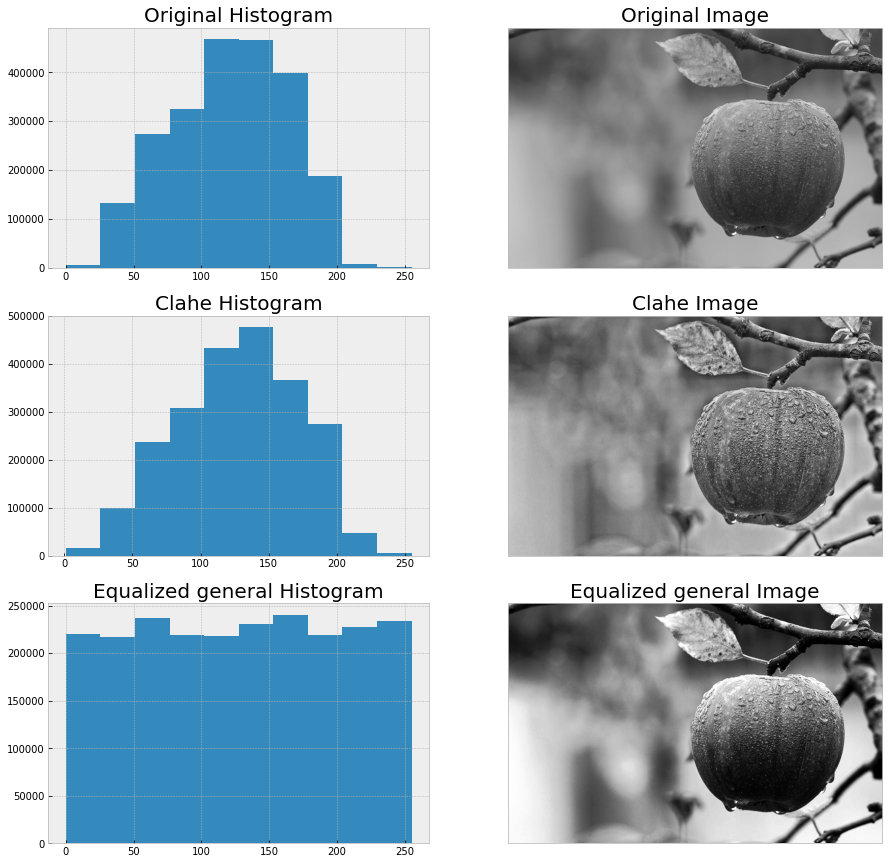

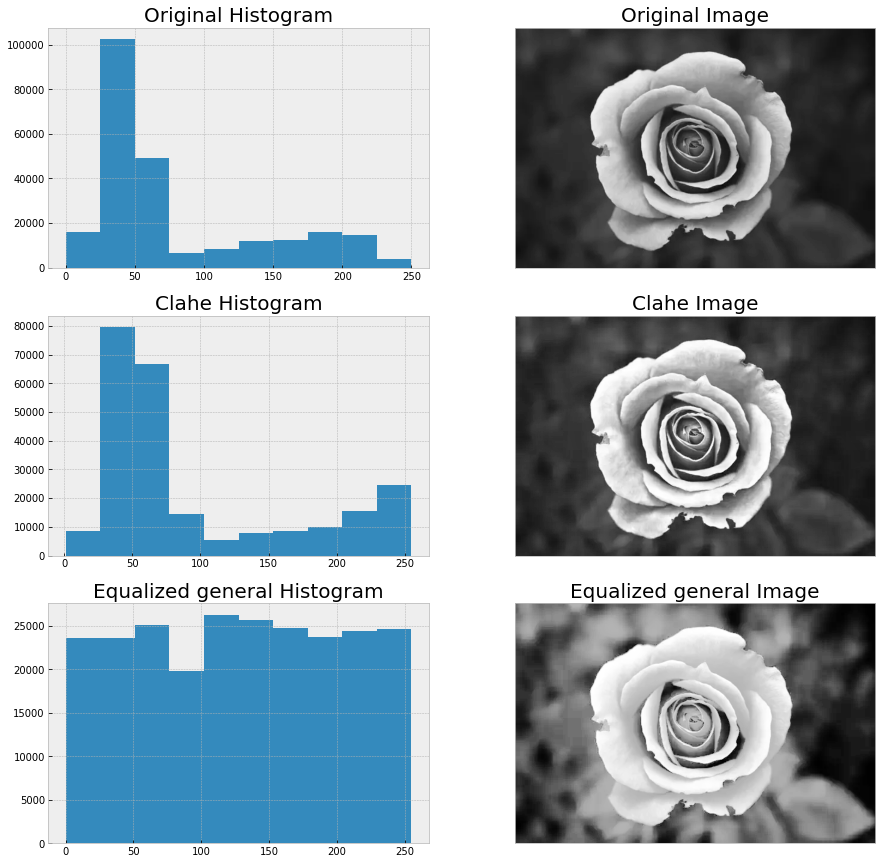

In [270]:

for path in img_list:
  img = load_image_url(path).convert("L")
  img_array = np.array(img)
  clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(32 ,32))
  img_tile_equalized_clahe = clahe.apply(img_array, )
  img_tile_equalized = cv2.equalizeHist(img_array)
  fig, axs = plt.subplots(3,2,figsize = (15, 15))
  axs[0,0].hist(img_array.ravel())
  axs[0,1].imshow(img_array, cmap = "gray")
  axs[0,0].set_title("Original Histogram", fontdict = {'fontsize': 20})
  axs[0,1].set_title("Original Image", fontdict = {'fontsize': 20})
  axs[0,1].xaxis.set_visible(False)
  axs[0,1].yaxis.set_visible(False)
  axs[1,0].hist(img_tile_equalized_clahe.ravel())
  axs[1,1].imshow(img_tile_equalized_clahe, cmap = "gray")
  axs[1,0].set_title("Clahe Histogram", fontdict = {'fontsize': 20})
  axs[1,1].set_title("Clahe Image", fontdict = {'fontsize': 20})
  axs[1,1].xaxis.set_visible(False)
  axs[1,1].yaxis.set_visible(False)

  axs[2,0].hist(img_tile_equalized.ravel())
  axs[2,1].imshow(img_tile_equalized, cmap = "gray")
  axs[2,0].set_title("Equalized general Histogram", fontdict = {'fontsize': 20})
  axs[2,1].set_title("Equalized general Image", fontdict = {'fontsize': 20})
  axs[2,1].xaxis.set_visible(False)
  axs[2,1].yaxis.set_visible(False)


  plt.show()

# Referencias

* Sund, Torbjørn & Møystad, Anne. (2006). Sliding window adaptive histogram equalization of intraoral radiographs: Effect on image quality. Dento maxillo facial radiology. 35. 133-8. 10.1259/dmfr/21936923. 

* OpenCV: Histograms - 2: Histogram Equalization. (s. f.). https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html


* Atul, K. &. (2019, 14 abril). Adaptive Histogram Equalization (AHE). TheAILearner. https://theailearner.com/2019/04/14/adaptive-histogram-equalization-ahe/